
# Assignment 3

This is a template notebook for Assignment 3.


## Install dependencies and initialization

In [ ]:
# The next 8 lines added to be compatible with version changes (2022/10/13).
# change cuda to 11.1
import os
p = os.getenv('PATH')
ld = os.getenv('LD_LIBRARY_PATH')
os.environ['PATH'] = f"/usr/local/cuda-11.1/bin:{p}"
os.environ['LD_LIBRARY_PATH'] = f"/usr/local/cuda-11.1/lib64:{ld}"
# change pytorch to 1.9.0 compiled with cuda 11.1
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html


# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html

!pip install torchsummary

!pip install tensorflow==2.0.0-alpha0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 GB 866.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.2/23.2 MB 71.0 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 1.13.1+cu116
    Uninstalling torch-1.13.1+cu116:
      Successfully uninstalled torch-1.13.1+cu116
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.14.1+cu116
    Uninstalling torchvision-0.14.1+cu116:
      Successfully uninstalled torchvision-0.14.1+cu116
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.14.1 requires torch==1.13.1, but you have torch 1.9.0+cu111 which is incompatible.
torchaudio 0.13.1+cu116 requires torch=

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement tensorflow==2.0.0-alpha0 (from versions: 2.2.0, 2.2.1, 2.2.2, 2.2.3, 2.3.0, 2.3.1, 2.3.2, 2.3.3, 2.3.4, 2.4.0, 2.4.1, 2.4.2, 2.4.3, 2.4.4, 2.5.0, 2.5.1, 2.5.2, 2.5.3, 2.6.0rc0, 2.6.0rc1, 2.6.0rc2, 2.6.0, 2.6.1, 2.6.2, 2.6.3, 2.6.4, 2.6.5, 2.7.0rc0, 2.7.0rc1, 2.7.0, 2.7.1, 2.7.2, 2.7.3, 2.7.4, 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.12.0rc0)
ERROR: No matching distribution found for tensorflow==2.0.0-alpha0


In [ ]:
!pwd # shows current directory
!ls  # shows all files in this directory
!nvidia-smi # shows the specs and the current status of the allocated GPU

/content
'=2.0.1'   sample_data
Tue Feb 28 02:49:52 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    26W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                        

In [ ]:
# import some common libraries
from google.colab.patches import cv2_imshow
from sklearn.metrics import jaccard_score
from PIL import Image, ImageDraw
from torchsummary import summary
from tqdm.notebook import tqdm
import pandas as pd
import numpy as np
import datetime
import random
import json
import cv2
import csv
import os

# import some common pytorch utilities
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torch.autograd import Variable
import torch.nn.functional as F
import torch.nn as nn
import torch

# import some common detectron2 utilities
import detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import Visualizer
from detectron2.data import build_detection_test_loader
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
setup_logger()

<Logger detectron2 (DEBUG)>

In [ ]:
# Make sure that GPU is available for your notebook. 
# Otherwise, you need to update the settungs in Runtime -> Change runtime type -> Hardware accelerator
torch.cuda.is_available()

True

In [ ]:
# You need to mount your google drive in order to load the data:
from google.colab import drive
drive.mount('/content/drive')
# Put all the corresponding data files in a data folder and put the data folder in a same directory with this notebook.
# Also create an output directory for your files such as the trained models and the output images.

Mounted at /content/drive


In [ ]:
# Define the location of current directory, which should contain data/train, data/test, and data/train.json.
# TODO: approx 1 line
import os
os.chdir("/content/drive/MyDrive/CMPT_CV_lab3")
BASE_DIR = '/content/drive/MyDrive/CMPT_CV_lab3'
OUTPUT_DIR = '{}/output'.format(BASE_DIR)
os.makedirs(OUTPUT_DIR, exist_ok=True)

## Part 1: Object Detection

### Data Loader

In [ ]:
'''
# This function should return a list of data samples in which each sample is a dictionary. 
# Make sure to select the correct bbox_mode for the data
# For the test data, you only have access to the images, therefore, the annotations should be empty.
# Other values could be obtained from the image files.
# TODO: approx 35 lines
'''
data_dirs = '{}/data/train.json'.format(BASE_DIR)
with open(data_dirs, "r", encoding="utf-8") as f:
  imgs_anns = json.load(f)
img_dir = '{}/data/train'.format(BASE_DIR)
training_dataset_dicts={}

for idx, v in enumerate(imgs_anns):
    filename = os.path.join(img_dir, v["file_name"])
    if not filename in training_dataset_dicts: #create file in not exists
          training_dataset_dicts[filename] = {}
          training_dataset_dicts[filename]['annotations'] = []
          width, height = Image.open(filename).size
          training_dataset_dicts[filename]['file_name'] = filename
          training_dataset_dicts[filename]['image_id'] = idx
          training_dataset_dicts[filename]['height'] = int(height)
          training_dataset_dicts[filename]['width'] = int(width)
    annotations = v["segmentation"]
    px = [annotations[0][i] for i in range(0, len(annotations[0]), 2)]
    py = [annotations[0][i] for i in range(1, len(annotations[0]), 2)]
    poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
    poly = [p for x in poly for p in x]
    obj = {
        "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": 0,
    }
    training_dataset_dicts[filename]['annotations'].append(obj)

training_dataset_dicts = np.array(list(training_dataset_dicts.values()))





def get_detection_data(set_name):
  if set_name != "test.json":
    return training_dataset_dicts.tolist()
  else:
    img_dir = '{}/data/test'.format(BASE_DIR) # ran out of memory here cause needs High-Ram in colab
    imgs_anns = os.listdir(img_dir)
    testing_dataset_dicts ={}
    for idx, v in enumerate(imgs_anns):
      filename = os.path.join(img_dir, v)
      if not filename in testing_dataset_dicts : #create file in not exists
            testing_dataset_dicts [filename] = {}
            testing_dataset_dicts [filename]['annotations'] = []
            width, height = Image.open(filename).size
            testing_dataset_dicts [filename]['file_name'] = filename
            testing_dataset_dicts [filename]['image_id'] = idx
            testing_dataset_dicts [filename]['height'] = int(height)
            testing_dataset_dicts [filename]['width'] = int(width)

    testing_dataset_dicts = np.array(list(testing_dataset_dicts.values())) 
    return testing_dataset_dicts.tolist() 


In [ ]:
'''
# Remember to add your dataset to DatasetCatalog and MetadataCatalog
# Consdier "data_detection_train" and "data_detection_test" for registration
# You can also add an optional "data_detection_val" for your validation by spliting the training data
# TODO: approx 5 lines
'''
# DatasetCatalog.remove('plane_train')
# DatasetCatalog.remove('plane_test')
# DatasetCatalog.remove('plane_validation')

for d in ["train","test",'validation']:
    DatasetCatalog.register("plane_" + d, lambda d=d: get_detection_data(d+'.json'))
    MetadataCatalog.get("plane_" + d).set(thing_classes=["planes"])
planes_metadata = MetadataCatalog.get("plane_train")

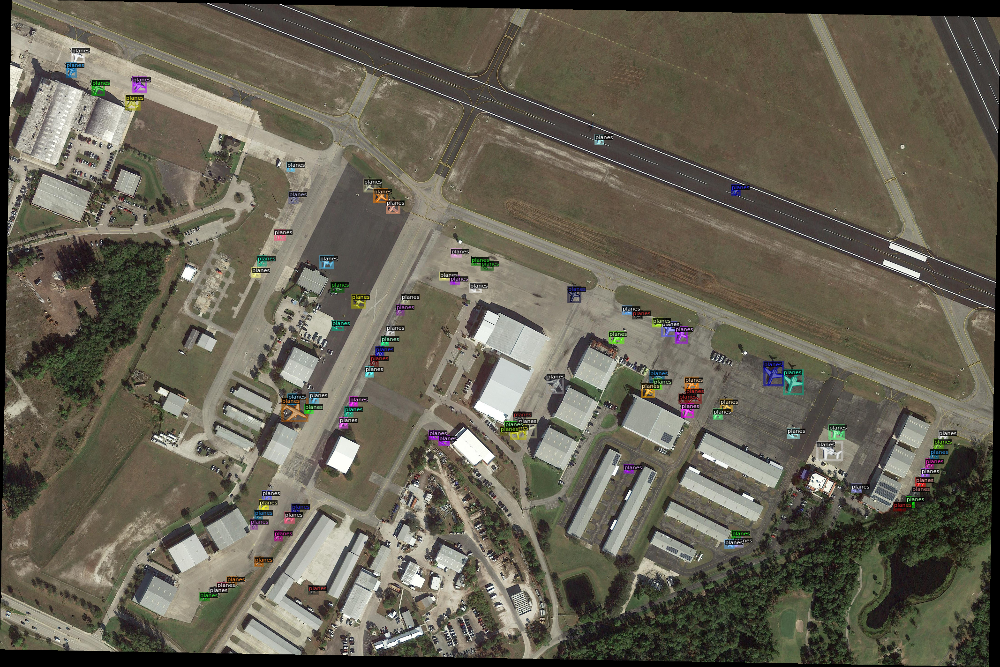

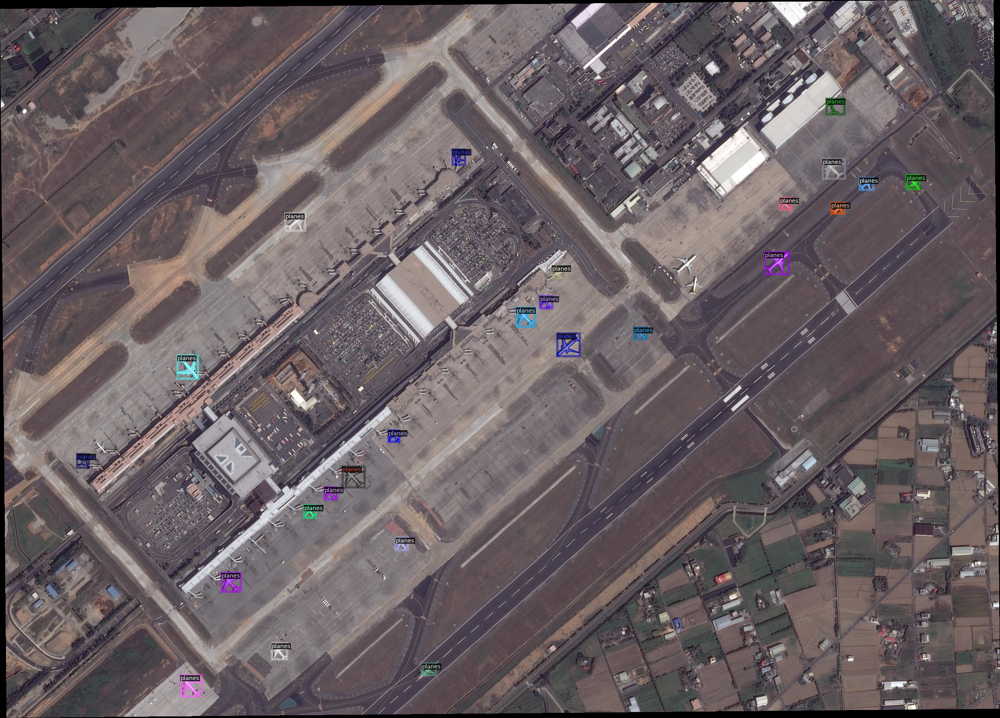

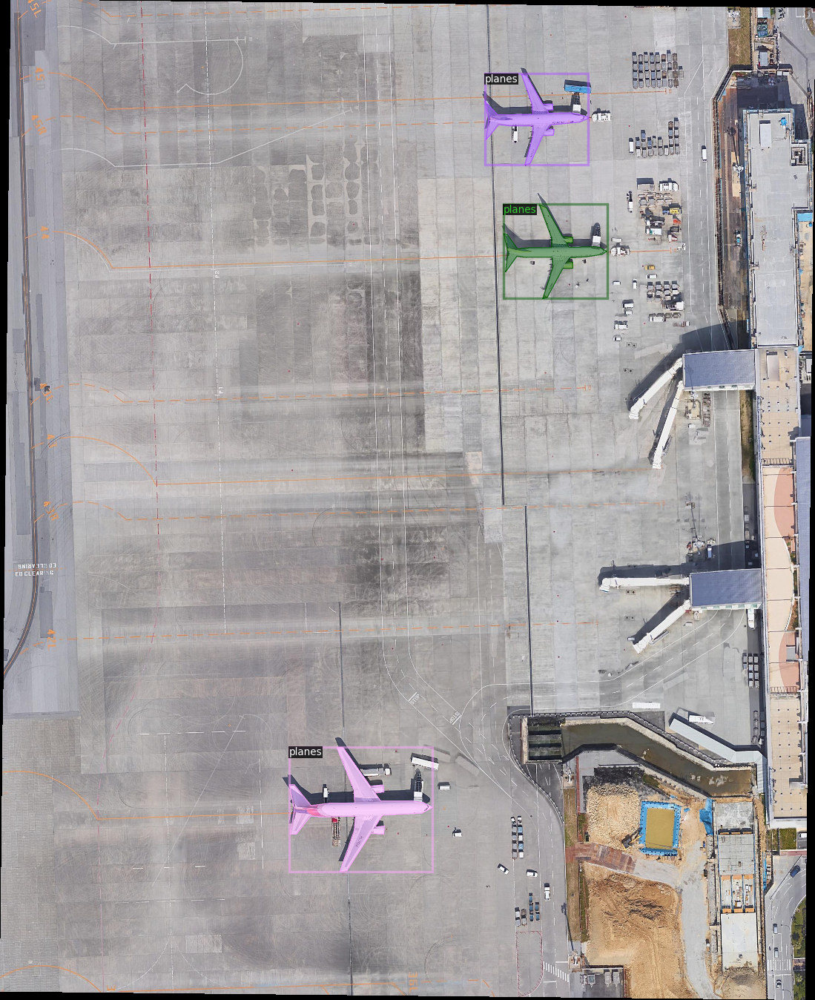

In [ ]:
'''
# Visualize some samples using Visualizer to make sure that the function works correctly
# TODO: approx 5 lines
'''
dataset_dicts = get_detection_data("train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=planes_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])


### Set Configs

In [ ]:
'''
# Set the configs for the detection part in here.
# TODO: approx 15 lines
'''
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("plane_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.0007  # pick a good LR
cfg.SOLVER.MAX_ITER = 800   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512  # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.OUTPUT_DIR = "{}/output/".format(BASE_DIR)
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

### Training

In [ ]:
'''
# Create a DefaultTrainer using the above config and train the model
# TODO: approx 5 lines
'''

trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[02/28 02:06:36 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[02/28 02:06:38 d2.engine.train_loop]: Starting training from iteration 0
[02/28 02:07:27 d2.utils.events]:  eta: 0:10:55  iter: 19  total_loss: 4.733  loss_cls: 0.6621  loss_box_reg: 0.3595  loss_rpn_cls: 3.003  loss_rpn_loc: 0.5344  time: 2.4220  data_time: 0.0905  lr: 6.427e-11  max_mem: 10134M
[02/28 02:08:14 d2.utils.events]:  eta: 0:10:03  iter: 39  total_loss: 4.492  loss_cls: 0.6566  loss_box_reg: 0.378  loss_rpn_cls: 2.919  loss_rpn_loc: 0.5662  time: 2.3895  data_time: 0.0185  lr: 1.3087e-10  max_mem: 10134M
[02/28 02:09:02 d2.utils.events]:  eta: 0:09:23  iter: 59  total_loss: 3.685  loss_cls: 0.6641  loss_box_reg: 0.3372  loss_rpn_cls: 2.288  loss_rpn_loc: 0.3993  time: 2.3854  data_time: 0.0436  lr: 1.9747e-10  max_mem: 10134M
[02/28 02:09:49 d2.utils.events]:  eta: 0:08:35  iter: 79  total_loss: 3.655  loss_cls: 0.6593  loss_box_reg: 0.3559  loss_rpn_cls: 1.979  loss_rpn_loc: 0.5362  time: 2.3713  data_time: 0.0129  lr: 2.6407e-10  max_mem: 10134M
[02/28 02:10:37 d2.utils

### Evaluation and Visualization

In [ ]:
!pip install tensorboard

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/CMPT_CV_lab3/output

<IPython.core.display.Javascript object>

In [ ]:
!kill

kill: usage: kill [-s sigspec | -n signum | -sigspec] pid | jobspec ... or kill -l [sigspec]


In [ ]:
'''
# After training the model, you need to update cfg.MODEL.WEIGHTS
# Define a DefaultPredictor
'''
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

prediction set


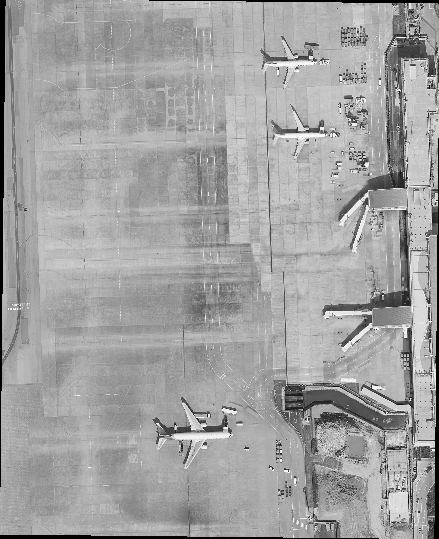

prediction set


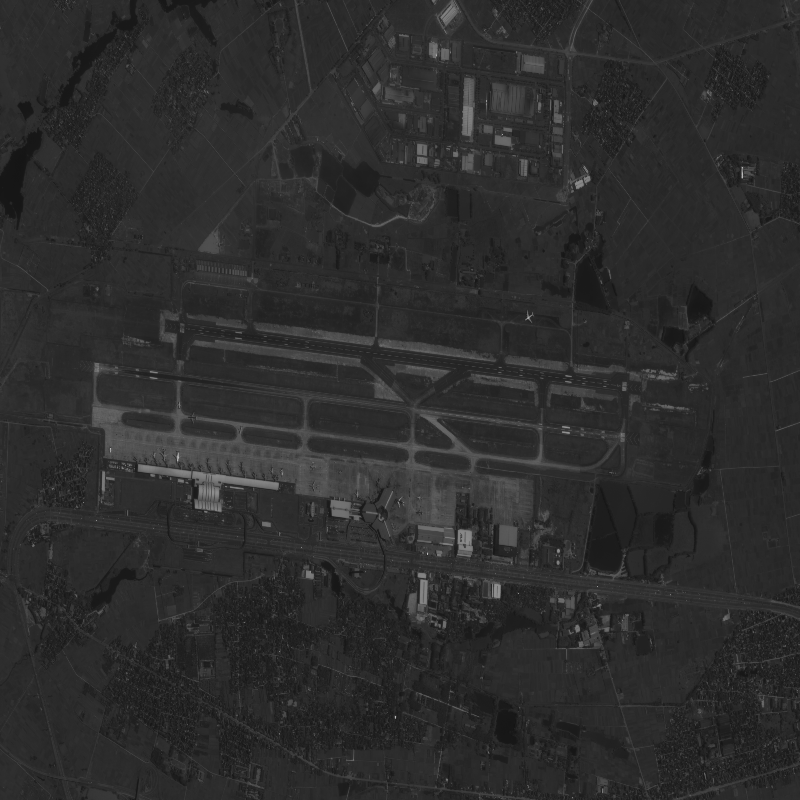

prediction set


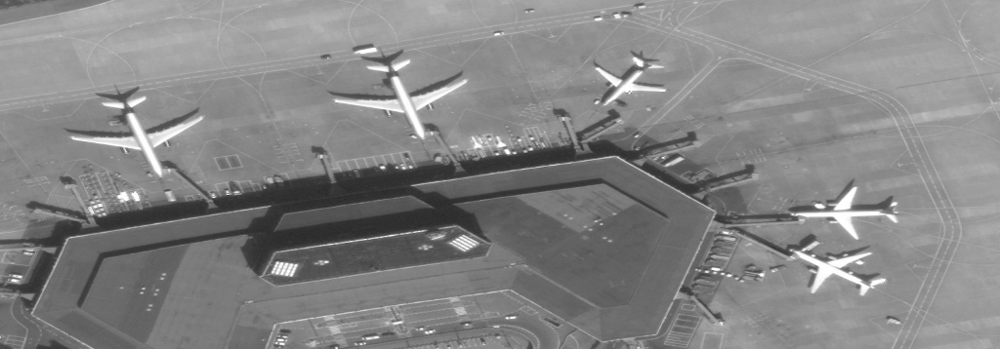

In [ ]:
'''
# Visualize the output for 3 random test samples
# TODO: approx 10 lines
'''
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_detection_data("test")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=planes_metadata, 
                   scale=0.2, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    print("prediction set")
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
'''
# Use COCOEvaluator and build_detection_train_loader
# You can save the output predictions using inference_on_dataset
# TODO: approx 5 lines
'''

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("plane_validation", cfg, False, output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "plane_validation")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

WARNING [02/28 02:04:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/28 02:04:38 d2.evaluation.coco_evaluation]: Trying to convert 'plane_validation' to COCO format ...
WARNING [02/28 02:04:38 d2.data.datasets.coco]: Using previously cached COCO format annotations at '/content/drive/MyDrive/CMPT_CV_lab3/output/plane_validation_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[02/28 02:04:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/28 02:04:39 d2.data.common]: Serializing 198 elements to byte tensors and concatenating them all ...
[02/28 02:04:40 d2.data.common]: Serialized dataset takes 45.73 MiB
[02/28 02:04:40 d2.evaluation.evaluator]: Start inference on 198 batches
[02/28 02:04:45 d2.evaluation.evaluator]: Inference do

### Improvements

For this part, you can bring any improvement which you have by adding new input parameters to the previous functions or defining new functions and variables.

In [ ]:
'''
# Bring any changes and updates regarding the improvement in here
'''


'\n# Bring any changes and updates regarding the improvement in here\n'

## Part 2: Semantic Segmentation

### Data Loader

In [ ]:
'''
# Write a function that returns the cropped image and corresponding mask regarding the target bounding box
# idx is the index of the target bbox in the data
# high-resolution image could be passed or could be load from data['file_name']
# You can use the mask attribute of detectron2.utils.visualizer.GenericMask 
#     to convert the segmentation annotations to binary masks
# TODO: approx 10 lines
'''

def get_instance_sample(data, img=None): # load all images at once instead of by idx
  filename = data['file_name']
  img = cv2.imread(filename)
  dic = {'img': [], 'mask':[]} # set a dic
  for idx in range(len(data['annotations'])): #idx value here BoxMode.XYXY_ABS
      annos = data['annotations'][idx]
      bbox = annos['bbox']
      x1,y1,x2,y2 = [int(i) for i in bbox] # since bounding box is in 
      
      obj_img = img[y1:y2, x1:x2]  # bounding box
      segs = annos['segmentation'][0]

      obj_mask = detectron2.utils.visualizer.GenericMask(data["annotations"][idx]["segmentation"], data['height'], data['width']).mask # mask the entire image
      obj_mask = obj_mask[y1:y2, x1:x2]*255  # bounding box

      obj_img = cv2.resize(obj_img, (128, 128), interpolation = cv2.INTER_AREA) # resize the image here cause it's a lot faster
      obj_mask = cv2.resize(obj_mask, (128, 128), interpolation = cv2.INTER_AREA) # resize the image here cause it's a lot faster
      
      dic['img'].append(obj_img)
      dic['mask'].append(obj_mask)
  return dic

In [ ]:

m = get_detection_data('train.json') 
data = {'img':[], 'masks':[]} # memoization adds all loading to a dic instead requires to switch to high
for i in tqdm(m):
    fname = i["file_name"].split('/')[-1].split('.')[0]
    dic = get_instance_sample(i)
    data['img']+=[dic['img']]
    data['masks']+=[dic['mask']]

  0%|          | 0/198 [00:00<?, ?it/s]

In [ ]:
'''
# We have provided a template data loader for your segmentation training
# You need to complete the __getitem__() function before running the code
# You may also need to add data augmentation or normalization in here
'''

class PlaneDataset(Dataset):
  def __init__(self, set_name, data_list):
      self.transforms = transforms.Compose([
          transforms.ToTensor(), # Converting the image to tensor and change the image format (Channels-Last => Channels-First)
      ])
      self.set_name = set_name
      self.data = data_list
      self.instance_map = []
      for i, d in enumerate(self.data):
        for j in range(len(d['annotations'])):
          self.instance_map.append([i,j])


  '''
  # you can change the value of length to a small number like 10 for debugging of your training procedure and overfeating
  # make sure to use the correct length for the final training
  '''
  def __len__(self):
      return len(self.instance_map)

  def numpy_to_tensor(self, img, mask):
    if self.transforms is not None:
        img = self.transforms(img)
        mask = self.transforms(mask)
    img = torch.as_tensor(img, dtype=torch.float)
    mask = torch.as_tensor(mask, dtype=torch.float)
    return img, mask

  '''
  # Complete this part by using get_instance_sample function
  # make sure to resize the img and mask to a fixed size (for example 128*128)
  # you can use "interpolate" function of pytorch or "numpy.resize"
  # TODO: 5 lines
  '''
  def __getitem__(self, idx): # use memorization to shorten loading time note need to use high-RAM cause this uses more than 15 GB of data
    if torch.is_tensor(idx):
        idx = idx.tolist()
    idx = self.instance_map[idx]
    #index data is global variable which we loaded early
    obj_mask = data['masks'][idx[0]][idx[1]] #index data is global variable which we loaded early
    obj_img = data['img'][idx[0]][idx[1]]
    img, mask = self.numpy_to_tensor(obj_img, obj_mask)    
    return img, mask

def get_plane_dataset(set_name='train', batch_size=2):
    my_data_list = DatasetCatalog.get("plane_{}".format(set_name))
    dataset = PlaneDataset(set_name, my_data_list)
    loader = DataLoader(dataset, batch_size=batch_size, num_workers=4,
                                              pin_memory=True, shuffle=True)
    return loader, dataset
     

### Network

In [ ]:
'''
# convolution module as a template layer consists of conv2d layer, batch normalization, and relu activation
'''
class conv(nn.Module):
    def __init__(self, in_ch, out_ch, activation=True):
        super(conv, self).__init__()
        if(activation):
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1),
             nn.BatchNorm2d(out_ch),
             nn.ReLU(inplace=True)
          )
        else:
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1)  
             )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# downsampling module equal to a conv module followed by a max-pool layer
'''
class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.layer = nn.Sequential(
            conv(in_ch, out_ch),
            nn.MaxPool2d(2)
            )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# upsampling module equal to a upsample function followed by a conv module
'''
class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=False):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

        self.conv = conv(in_ch, out_ch)

    def forward(self, x):
        y = self.up(x)
        y = self.conv(y)
        return y

'''
# the main model which you need to complete by using above modules.
# you can also modify the above modules in order to improve your results.
'''
class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        
        self.input_conv = conv(3, 8)
        self.down1 = down(8, 16)
        self.down2 = down(16, 32)
        self.down3 = down(32, 64)
        self.down4 = down(64, 128)
        self.down5 = down(128, 256)
        self.down6 = down(256, 512)
        
        # Decoder
        
        self.up1 = up(512, 256)
        self.up2 = up(256, 128)
        self.up3 = up(128, 64)
        self.up4 = up(64, 32)
        self.up5 = up(32, 16)
        self.up6 = up(16, 8)
        self.up7 = conv(8, 3)
        self.output_conv = conv(3, 1, False) # ReLu activation is removed to keep the logits for the loss function
        
        self.normal1 = nn.BatchNorm2d(8)
        self.normal2 = nn.BatchNorm2d(16)
        self.normal3 = nn.BatchNorm2d(32)
        self.normal4 = nn.BatchNorm2d(64)
        self.normal5 = nn.BatchNorm2d(128)
        self.normal6 = nn.BatchNorm2d(256)

    def forward(self, input): #UNET model but with at max 512 since running out of time also skipped 
      y1 = self.input_conv(input)
      y2 = self.down1(y1)
      y3 = self.down2(y2)
      y4 = self.down3(y3)
      y5 = self.down4(y4)
      y6 = self.down5(y5)
      y7 = self.down6(y6)
      y7 = self.normal6(F.relu(self.up1(y7) + y6))
      y6 = self.normal5(F.relu(self.up2(y7) + y5))
      y5 = self.normal4(F.relu(self.up3(y6) + y4))
      y4 = self.normal3(F.relu(self.up4(y5) + y3))
      y3 = self.normal2(F.relu(self.up5(y4) + y2))
      y2 = self.normal1(F.relu(self.up6(y3) + y1))
      y = self.up7(y2)
      output = self.output_conv(y)
      return output

Summary of Model

In [ ]:
model = MyModel().cuda()
summary(model, (3,128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 128, 128]             224
       BatchNorm2d-2          [-1, 8, 128, 128]              16
              ReLU-3          [-1, 8, 128, 128]               0
              conv-4          [-1, 8, 128, 128]               0
            Conv2d-5         [-1, 16, 128, 128]           1,168
       BatchNorm2d-6         [-1, 16, 128, 128]              32
              ReLU-7         [-1, 16, 128, 128]               0
              conv-8         [-1, 16, 128, 128]               0
         MaxPool2d-9           [-1, 16, 64, 64]               0
             down-10           [-1, 16, 64, 64]               0
           Conv2d-11           [-1, 32, 64, 64]           4,640
      BatchNorm2d-12           [-1, 32, 64, 64]              64
             ReLU-13           [-1, 32, 64, 64]               0
             conv-14           [-1, 32,

### Training

In [ ]:
'''
# The following is a basic training procedure to train the network
# You need to update the code to get the best performance
# TODO: approx ? lines
'''

# Set the hyperparameters
num_epochs = 60
batch_size = 8
learning_rate = 0.1
weight_decay = 1e-5

model = MyModel() # initialize the model
model = model.cuda() # move the model to GPU
loader, _ = get_plane_dataset('train', batch_size) # initialize data_loader
crit = nn.BCEWithLogitsLoss() # Define the loss function
optim = torch.optim.SGD(model.parameters(), lr=learning_rate, weight_decay=weight_decay) # Initialize the optimizer as SGD

# start the training procedure
for epoch in range(num_epochs):
  total_loss = 0
  for (img, mask) in tqdm(loader):
    img = torch.tensor(img, device=torch.device('cuda'), requires_grad = True)
    mask = torch.tensor(mask, device=torch.device('cuda'), requires_grad = True)
    pred = model(img)
    loss = crit(pred, mask)
    optim.zero_grad()
    loss.backward()
    optim.step()
    total_loss += loss.cpu().data
  print("Epoch: {}, Loss: {}".format(epoch, total_loss/len(loader)))
  torch.save(model.state_dict(), '{}/output/{}_segmentation_model.pth'.format(BASE_DIR, epoch))

'''
# Saving the final model
'''
torch.save(model.state_dict(), '{}/output/final_segmentation_model.pth'.format(BASE_DIR))


  0%|          | 0/998 [00:00<?, ?it/s]

<ipython-input-24-756698463748>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, device=torch.device('cuda'), requires_grad = True)
<ipython-input-24-756698463748>:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask, device=torch.device('cuda'), requires_grad = True)


Epoch: 0, Loss: 0.26221928000450134


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 1, Loss: 0.19535145163536072


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 2, Loss: 0.1770019233226776


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 3, Loss: 0.16575424373149872


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 4, Loss: 0.15696954727172852


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 5, Loss: 0.1503874808549881


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 6, Loss: 0.14365564286708832


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 7, Loss: 0.13740578293800354


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 8, Loss: 0.13282401859760284


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 9, Loss: 0.12862378358840942


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 10, Loss: 0.12429757416248322


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 11, Loss: 0.12066681683063507


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 12, Loss: 0.11711006611585617


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 13, Loss: 0.1141090989112854


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 14, Loss: 0.11033371090888977


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 15, Loss: 0.10774403810501099


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 16, Loss: 0.1051446795463562


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 17, Loss: 0.10209818184375763


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 18, Loss: 0.09927674382925034


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 19, Loss: 0.09719211608171463


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 20, Loss: 0.09488566219806671


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 21, Loss: 0.09332013130187988


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 22, Loss: 0.09099715948104858


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 23, Loss: 0.08883029967546463


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 24, Loss: 0.08700757473707199


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 25, Loss: 0.08544060587882996


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 26, Loss: 0.08335968852043152


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 27, Loss: 0.08232038468122482


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 28, Loss: 0.08082561939954758


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 29, Loss: 0.07940448075532913


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 30, Loss: 0.07858919352293015


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 31, Loss: 0.07706033438444138


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 32, Loss: 0.07562582194805145


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 33, Loss: 0.07454707473516464


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 34, Loss: 0.07352887839078903


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 35, Loss: 0.07269025593996048


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 36, Loss: 0.0716368556022644


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 37, Loss: 0.07070305943489075


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 38, Loss: 0.07039794325828552


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 39, Loss: 0.06897243112325668


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 40, Loss: 0.06813759356737137


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 41, Loss: 0.06703194230794907


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 42, Loss: 0.06639895588159561


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 43, Loss: 0.0657457485795021


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 44, Loss: 0.0657816007733345


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 45, Loss: 0.064690001308918


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 46, Loss: 0.06391288340091705


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 47, Loss: 0.06323087215423584


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 48, Loss: 0.06270352005958557


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 49, Loss: 0.0622103288769722


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 50, Loss: 0.061421774327754974


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 51, Loss: 0.06116095930337906


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 52, Loss: 0.06065904721617699


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 53, Loss: 0.06024719774723053


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 54, Loss: 0.059755586087703705


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 55, Loss: 0.05948225408792496


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 56, Loss: 0.05890930816531181


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 57, Loss: 0.058423057198524475


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 58, Loss: 0.057839807122945786


  0%|          | 0/998 [00:00<?, ?it/s]

Epoch: 59, Loss: 0.057521846145391464


### Evaluation and Visualization

In [ ]:
'''
# Before starting the evaluation, you need to set the model mode to eval
# You may load the trained model again, in case if you want to continue your code later
# TODO: approx 15 lines
'''
def sigmoid(x): # formula from online
  return 1/(1 + np.exp(-x))

def iou_coef(y_true, y_pred): # formula from online
  y_true = np.rint(sigmoid(y_true))
  y_pred = np.rint(sigmoid(y_pred))
  intersection = np.count_nonzero(np.multiply(y_true, y_pred))
  union = np.count_nonzero(y_true+y_pred)
  if union == 0:
      return 0
  return intersection/union


batch_size = 8
model = MyModel().cuda()
model.load_state_dict(torch.load('{}/output/final_segmentation_model.pth'.format(BASE_DIR)))
model = model.eval() # chaning the model to evaluation mode will fix the bachnorm layers
loader, dataset = get_plane_dataset('train', batch_size)

total_iou = 0
count = 0
for (img, mask) in tqdm(loader):
  with torch.no_grad():
    img = img.cuda()
    mask = mask.cuda()
    mask = torch.unsqueeze(mask,1)
    pred = model(img)

    '''
    ## Complete the code by obtaining the IoU for each img and print the final Mean IoU
    '''
    for i in range(img.shape[0]):
        predicted = np.array(pred[i].cpu())[0]
        masked = np.array(mask[i].cpu())[0]
        count+=1 #number of images
        total_iou+=iou_coef(masked, predicted)

print("\n #images: {}, Mean IoU: {}".format(count, total_iou/count))


  0%|          | 0/998 [00:00<?, ?it/s]


 #images: 7980, Mean IoU: 0.9084144347077819


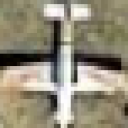

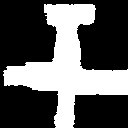

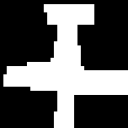

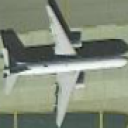

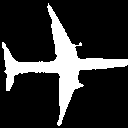

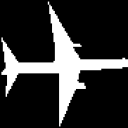

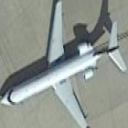

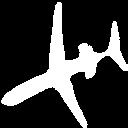

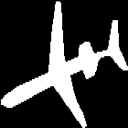

In [ ]:
'''
# Visualize 3 sample outputs
# TODO: approx 5 lines
'''
batch_size = 3
loader, dataset = get_plane_dataset('train', batch_size)

img, mask = next(iter(loader))
with torch.no_grad():
    img = img.cuda()
    mask = mask.cpu().detach()
    pred = model(img).cpu().detach()
    for i in range(img.shape[0]):
        cropped_img = transforms.ToPILImage()(img[i].cpu())
        cv2_imshow(np.array(cropped_img))
        predicted = np.rint(sigmoid(np.array(pred[i])[0]))*255
        masked = np.array(mask[i])[0]*255
        cv2_imshow(predicted)
        cv2_imshow(masked)

## Part 3: Instance Segmentation

In this part, you need to obtain the instance segmentation results for the test data by using the trained segmentation model in the previous part and the detection model in Part 1.

### Get Prediction

In [ ]:
'''
# Define a new function to obtain the prediction mask by passing a sample data
# For this part, you need to use all the previous parts (predictor, get_instance_sample, data preprocessings, etc)
# It is better to keep everything (as well as the output of this funcion) on gpu as tensors to speed up the operations.
# pred_mask is the instance segmentation result and should have different values for different planes.
# TODO: approx 35 lines
'''

def get_prediction_mask(data,training_set = False):# use np A[y1:y2,x1:x2] where y1,x1,y2,x2 is bounding box and resize image
  dic = get_instance_sample(data)
  filename = data['file_name']
  img = cv2.imread(filename)
  if training_set:
    gt_mask = np.zeros((data['height'],data['width']))
    pred_mask = np.zeros((data['height'],data['width']))
    for idx  in range(len(data['annotations'])): #idx value here BoxMode.XYXY_ABS
        annos = data['annotations'][idx]
        bbox = annos['bbox']
        x1,y1,x2,y2 = [int(i) for i in bbox] # since bounding box is in
        #pred_mask[x1:x2,y1:y2] = model(dic["mask"][idx]).cpu().detach()
        
        width = x2-x1
        height = y2-y1
        dim = (width,height)
        mask =cv2.resize(dic["mask"][idx], dim, interpolation = cv2.INTER_AREA) #reshape to orignal image 

        gt_mask[y1:y2, x1:x2] = mask #grounding mask

        sub_mask = img[y1:y2, x1:x2]
        sub_mask = cv2.resize(sub_mask, (128, 128), interpolation = cv2.INTER_AREA) # resize
        
        temp_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(sub_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] #got online
            
        temp_mask = cv2.resize(temp_mask[0] , dim, interpolation = cv2.INTER_AREA)
        temp_mask = np.rint(sigmoid(temp_mask))*(idx+1) # correct edit
        pred_mask[y1:y2, x1:x2] = temp_mask
  else:
    
    output = predictor(img)['instances']
    gt_mask = np.zeros((data['height'],data['width']))
    pred_mask = np.zeros((data['height'],data['width']))
    for i in range(len(output)):
      bbox = np.array(np.floor(list(output[i]._fields['pred_boxes'])[0].cpu().numpy()), dtype=np.uint32) # Getting the bounding boxes
      x1, y1, x2, y2 = bbox
      width = x2-x1
      height = y2-y1
      dim = (width,height)
      sub_mask = img[y1:y2, x1:x2]
      sub_mask = cv2.resize(sub_mask, (128, 128), interpolation = cv2.INTER_AREA) # resize
      
      temp_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(sub_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] #got online
          
      temp_mask = cv2.resize(temp_mask[0] , dim, interpolation = cv2.INTER_AREA)
      temp_mask = np.rint(sigmoid(temp_mask))*(i+1) # correct edit
      pred_mask[y1:y2, x1:x2] = temp_mask
    for idx  in range(len(data['annotations'])): #idx value here BoxMode.XYXY_ABS
      annos = data['annotations'][idx]
      bbox = annos['bbox']
      x1,y1,x2,y2 = [int(i) for i in bbox] # since bounding box is in
      #pred_mask[x1:x2,y1:y2] = model(dic["mask"][idx]).cpu().detach()
      
      width = x2-x1
      height = y2-y1
      dim = (width,height)
      mask =cv2.resize(dic["mask"][idx], dim, interpolation = cv2.INTER_AREA) #reshape to orignal image 

      gt_mask[y1:y2, x1:x2] = mask #grounding mask
  return img, torch.tensor(gt_mask, device=torch.device('cuda')) , torch.tensor(pred_mask, device=torch.device('cuda')) # gt_mask could be all zero when the ground truth is not given.


### Visualization and Submission

<ipython-input-27-51e23b42e79d>:32: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  temp_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(sub_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] #got online


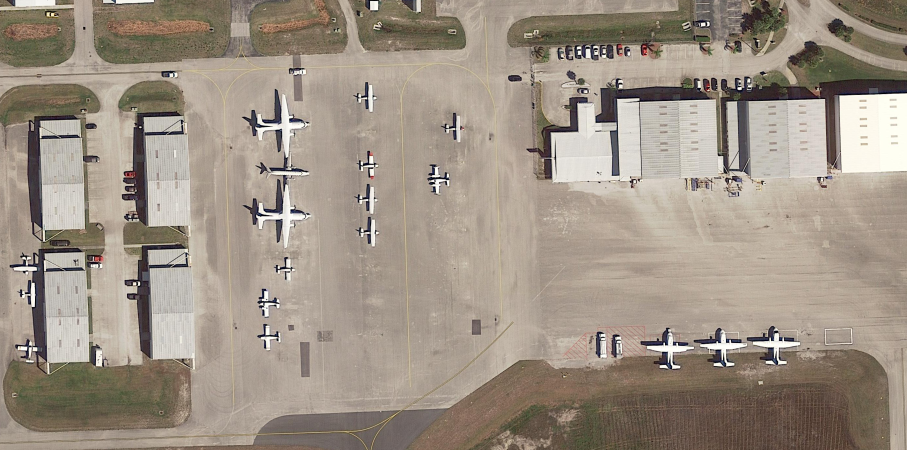

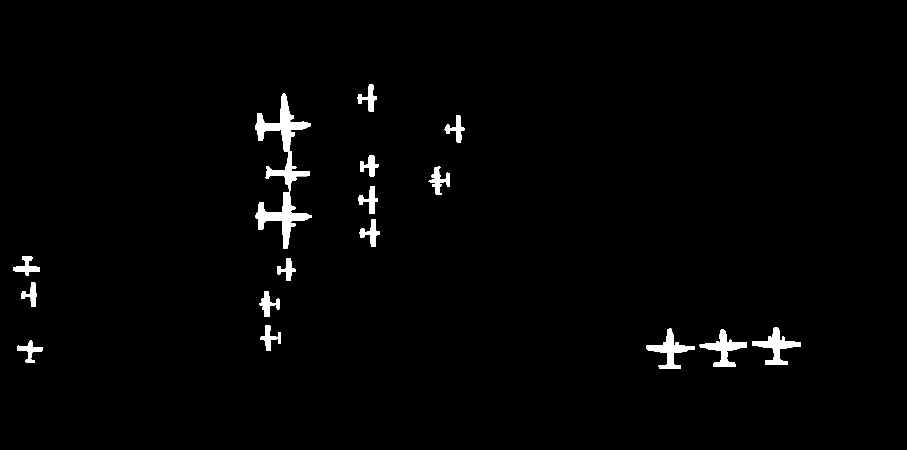

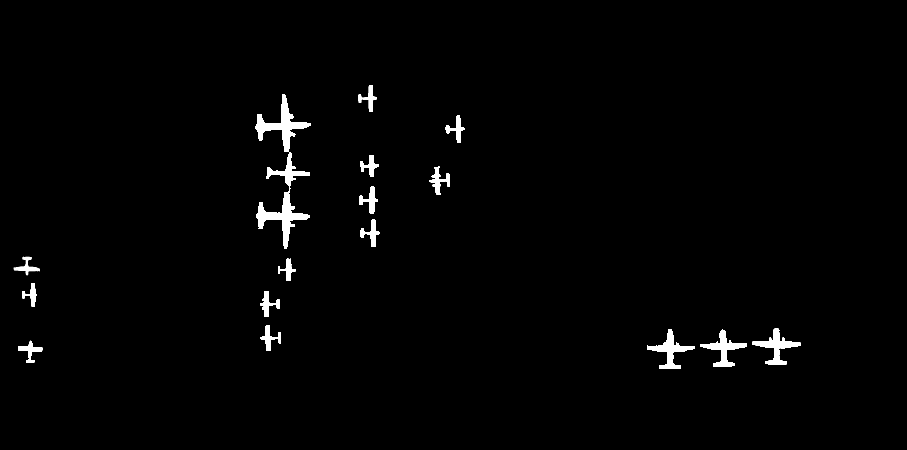

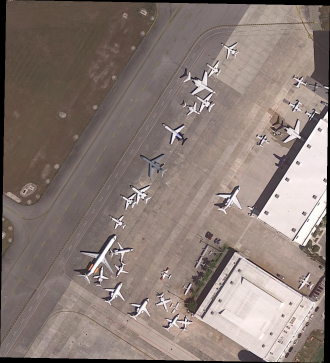

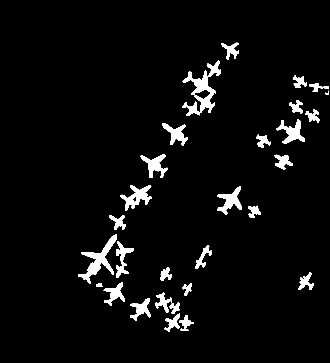

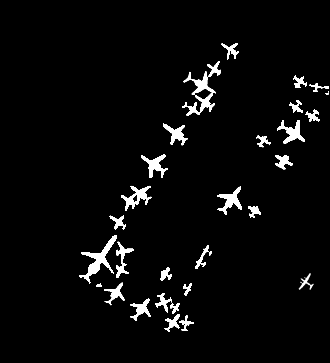

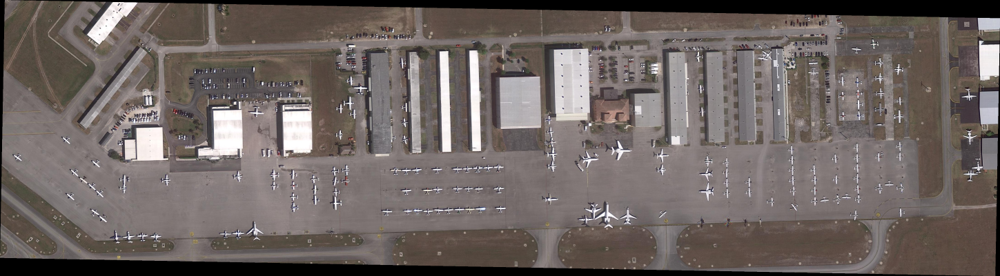

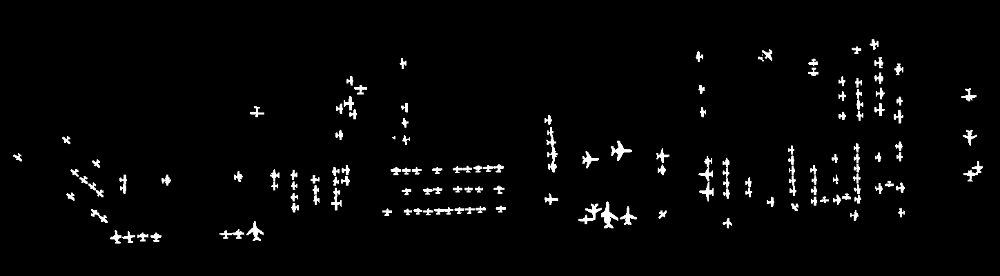

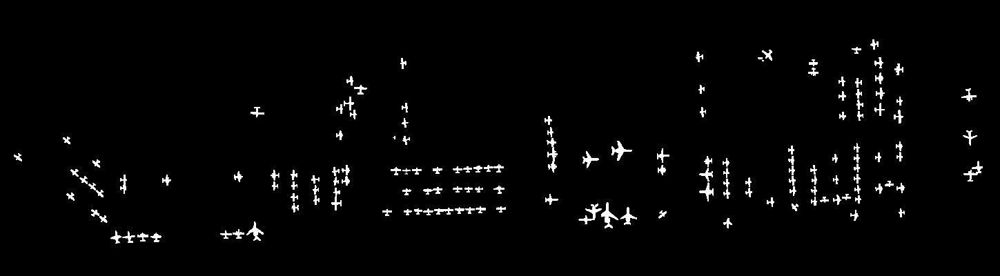

In [ ]:
'''
# Visualise the output prediction as well as the GT Mask and Input image for a sample input
# TODO: approx 10 lines
'''
my_data_list = DatasetCatalog.get("plane_{}".format('train'))
for d in random.sample(my_data_list, 3):
    img, gt_mask, pred_mask = get_prediction_mask(d,True)
    # img, gt_mask = get_prediction_mask(d)      
    gt_mask = np.array(gt_mask.cpu())*255
    pred_mask = np.array(pred_mask.cpu())*255
    cv2_imshow(cv2.resize(img, (img.shape[1]//3, img.shape[0]//3), interpolation = cv2.INTER_AREA))
    cv2_imshow(cv2.resize(gt_mask, (gt_mask.shape[1]//3, gt_mask.shape[0]//3), interpolation = cv2.INTER_AREA))
    cv2_imshow(cv2.resize(pred_mask, (pred_mask.shape[1]//3, pred_mask.shape[0]//3), interpolation = cv2.INTER_AREA))



In [ ]:
'''
# ref: https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# https://www.kaggle.com/c/airbus-ship-detection/overview/evaluation
'''
def rle_encoding(x):
    '''
    x: pytorch tensor on gpu, 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = torch.where(torch.flatten(x.long())==1)[0]
    if(len(dots)==0):
      return []
    inds = torch.where(dots[1:]!=dots[:-1]+1)[0]+1
    inds = torch.cat((torch.tensor([0], device=torch.device('cuda'), dtype=torch.long), inds))
    tmpdots = dots[inds]
    inds = torch.cat((inds, torch.tensor([len(dots)], device=torch.device('cuda'))))
    inds = inds[1:] - inds[:-1]
    runs = torch.cat((tmpdots, inds)).reshape((2,-1))
    runs = torch.flatten(torch.transpose(runs, 0, 1)).cpu().data.numpy()
    return ' '.join([str(i) for i in runs])

In [ ]:
'''
# You need to upload the csv file on kaggle
# The speed of your code in the previous parts highly affects the running time of this part
'''

preddic = {"ImageId": [], "EncodedPixels": []}

'''
# Writing the predictions of the training set
'''
my_data_list = DatasetCatalog.get("plane_{}".format('train'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample,True)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for index in inds:
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index)
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

'''
# Writing the predictions of the test set
'''

my_data_list = DatasetCatalog.get("plane_{}".format('test'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  img, true_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for j, index in enumerate(inds):
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index).double()
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

pred_file = open("{}/pred.csv".format(BASE_DIR), 'w')
pd.DataFrame(preddic).to_csv(pred_file, index=False)
pred_file.close()


  0%|          | 0/198 [00:00<?, ?it/s]

<ipython-input-27-51e23b42e79d>:32: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  temp_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(sub_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] #got online


  0%|          | 0/72 [00:00<?, ?it/s]

<ipython-input-27-51e23b42e79d>:51: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  temp_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(sub_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] #got online


## Part 4: Mask R-CNN

For this part you need to follow a same procedure to part 2 with the configs of Mask R-CNN, other parts are generally the same as part 2.

### Data Loader

In [ ]:
for d in ["train","test",'validation']:
    DatasetCatalog.register("plane_" + d, lambda d=d: get_detection_data(d+'.json'))
    MetadataCatalog.get("plane_" + d).set(thing_classes=["planes"])
planes_metadata = MetadataCatalog.get("plane_train")

### Network

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")) # already used in part 1 from tutorial
cfg.DATASETS.TRAIN = ("plane_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.0007  # pick a good LR
cfg.SOLVER.MAX_ITER = 800    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512  # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.OUTPUT_DIR = "{}/output/".format(BASE_DIR)
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

### Training

In [ ]:
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set a custom testing threshold
predictor = DefaultPredictor(cfg)


[02/28 02:53:57 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:09, 18.7MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}
backbone.bottom_up.res2.0.conv1.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.0.conv1.weight
backbone.bottom_up.res2.0.conv2.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.0.conv2.weight
backbone.bottom_up.res2.0.conv3.weight
backbone.bottom_up.res2.1.conv1.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.1.conv1.weight
backbone.bottom_up.res2.1.conv2.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.1.conv2.weight
backbone.bottom_up.res2.1.conv3.weight
backbone.bottom_up.res2.2.conv1.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.2.conv1.weight
backbone.bottom_up.res2.2.conv2.norm.{bias, running_mean, running_var, weight}
backbone.bottom_up.res2.2.conv2.wei

### Evaluation and Visualization

/usr/local/lib/python3.8/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


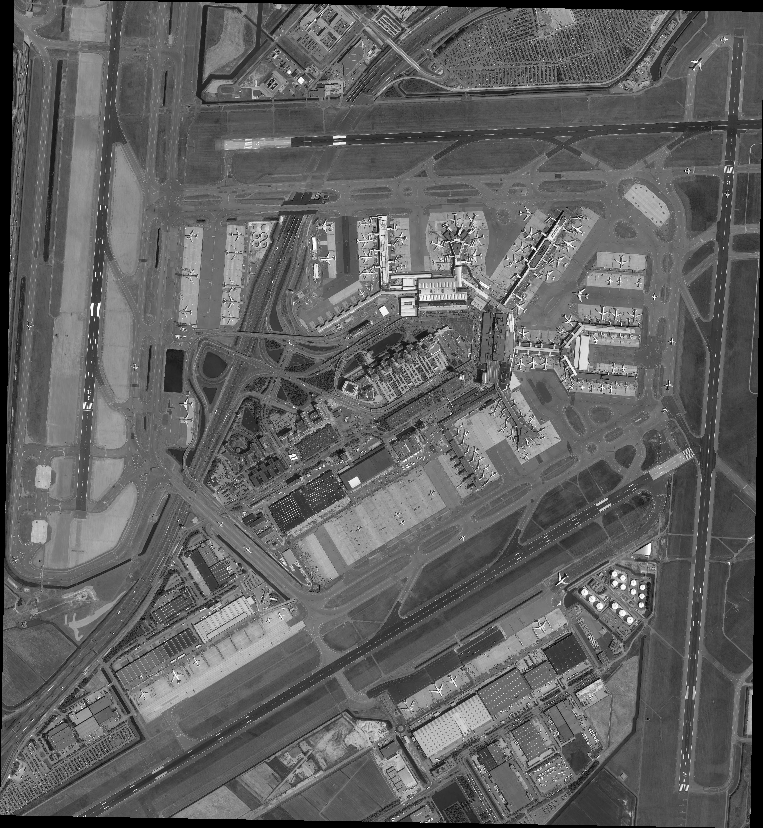

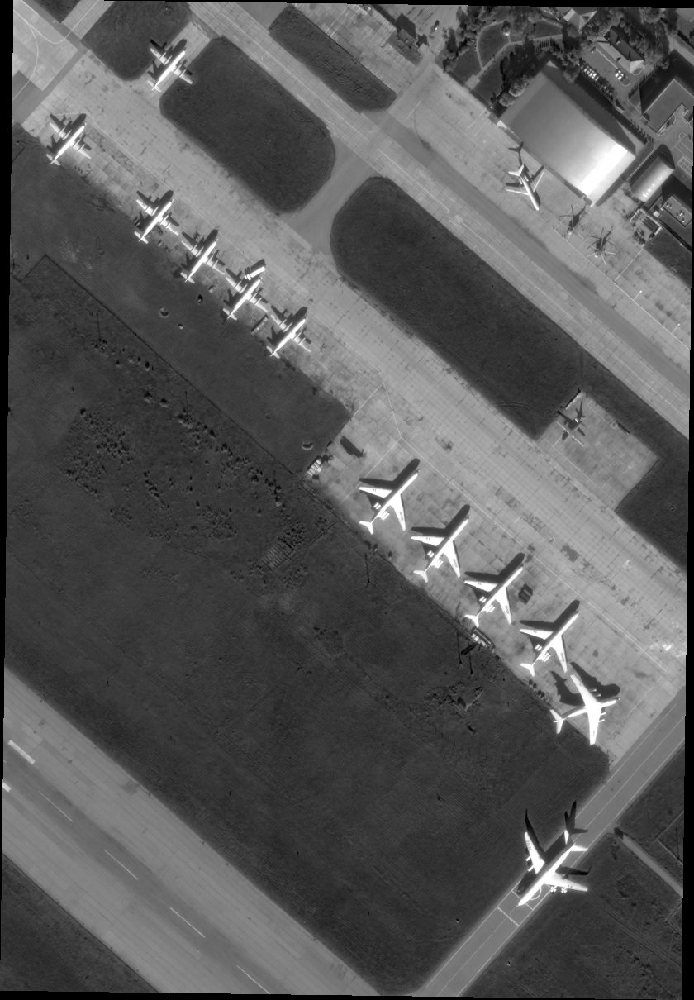

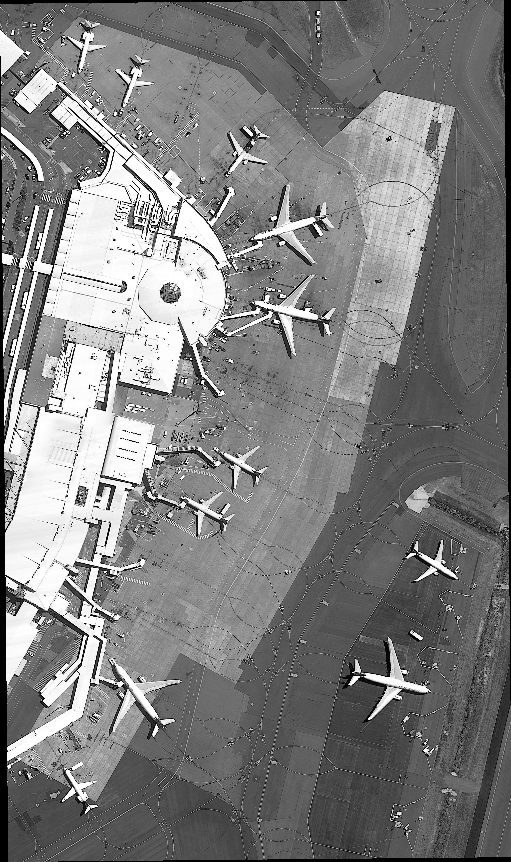

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_detection_data("validation.json")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=planes_metadata, 
                   scale=0.2, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("plane_validation", cfg, False, output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "plane_validation")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [02/28 02:54:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/28 02:54:37 d2.evaluation.coco_evaluation]: Trying to convert 'plane_validation' to COCO format ...
WARNING [02/28 02:54:37 d2.data.datasets.coco]: Using previously cached COCO format annotations at '/content/drive/MyDrive/CMPT_CV_lab3/output/plane_validation_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[02/28 02:54:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/28 02:54:39 d2.data.common]: Serializing 198 elements to byte tensors and concatenating them all ...
[02/28 02:54:39 d2.data.common]: Serialized dataset takes 45.73 MiB
[02/28 02:54:39 d2.evaluation.evaluator]: Start inference on 198 batches
[02/28 02:56:00 d2.evaluation.evaluator]: Inference do